In [1]:
import numpy as np
import matplotlib.pyplot as plt
import dedalus.public as d3
import logging
logger = logging.getLogger(__name__)

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import matplotlib as mpl
mpl.rc('text', usetex = True)
mpl.rc('font', family = 'serif')
mpl.rc('xtick', labelsize=18) 
mpl.rc('ytick', labelsize=18) 
mpl.rcParams.update({'font.size': 18})


Here I'm going to stick with the axisymmetric case (again to test the procedure) but expand the spectral method to 2D. I won't explicitly assume separability of $r$ and $\theta$ but if I define my bathymetry to be symmetric it *should* still give the same answer.

Now we are assuming solutions of the form,

$$\Psi(r,\theta,t) = \Re\Big\{ \Phi(r,\theta)\, e^{-2i\omega\Omega t}\Big\}$$

(i.e. we do not assume separability of $r$ and $\theta$) to the Topographic Rossby Wave Equation for linear barotropic CSWs. This means the problem we are solving is,

$$\frac{1}{H}\nabla^2\Phi + \nabla\Big(\frac{1}{H}\Big)\cdot \nabla \Phi +\frac{i}{\omega}\boldsymbol{\hat{k}}\cdot\Big(\nabla \Phi \times \nabla\Big(\frac{1}{H}\Big)\Big)=0$$

over the domain $r\in(a,1)$, $\theta\in (0,2\pi)$ subject to the boundary conditions 
$$\Phi(r=a, \theta) = 0$$
and a Dirichlet-to_Neumann BC at the outer boundary.
 Note here that $\Psi$ and $H$ are (nominally, in this contrived example where the symmetry is retained but we expand to 2D) functions of both $r$ and $\theta$.
 
 
 We will take Chebyshev points for the $r$ axis and Fourier points for the $\theta$ axis (note - no additional BCs needed here). Defining the basis this way (as opposed to an annulus basis) means I will need to expand the vector calculus notation above but it avoids the issue of having to wait for a 2D implementation of `cross` in Dedalus (i.e. $\boldsymbol{\hat{k}}\cdot(\boldsymbol{a}\times \boldsymbol{b})$ where $\boldsymbol{a}$ and $\boldsymbol{b}$ are 2D, this currently doesnt work). There may be *some* performence reduction on account of all the $r^{-1}$ geometric terms that the coordinate transfer introduces (these aren't great on Chebyshev) but it should probably be okay.


We'll need to include tau terms again and I'm going to start off with a simple second order expression,

$$\underbrace{\frac{1}{H} \Big(\partial_{rr}\Phi +\frac{1}{r}\partial_{r}\Phi + \frac{1}{r^2}\partial_{\theta\theta}\Phi\Big)}_{\frac{1}{H}\nabla^2\Phi}+    \underbrace{\partial_r\Phi \partial_r \big(\frac{1}{H}\big)+\frac{1}{r^2}\partial_\theta\Phi \partial_\theta \big(\frac{1}{H}\big)}_{\nabla(\frac{1}{H})\cdot \nabla \Phi}+
\underbrace{\frac{i}{r \omega}\Big(\partial_r\Phi \partial_\theta\big(\frac{1}{H}\big)-\partial_\theta\Phi \partial_r\big(\frac{1}{H}\big)   \Big)}_{\frac{i}{\omega}\boldsymbol{\hat{k}}\cdot(\nabla \Phi \times \nabla(\frac{1}{H}))}+\tau_1 V_{n-1}+\tau_2  V_{n-2}=0.$$



There were some complications with the initial implementation of the above on accound of incorrect BCs. I will make notes on this on the iPad but essentially I misunderstood how to implement the Dirichlet-to-Neumann BC at the annulus edge and was imposing a BC of the same order (second order differential equation BC to second order differential equation...). So more thought is needed re the implementation of the outer BC.


There are two options I can see:

1) Firstly, we could keep the Dirichlet-to-Neumann BC and translate it to an appropriate form. This is a bit beyond me but requires the use of Hilbert spaces or something. Anyway, Keaton has coded up something that will hopefully work.

2) Secondly we could just expand the domain and impose a more simple BD of setting the pressure field to zero in the far field of the flat bathymetry area. (**Update: I looked into this and it isn't feasible. The $\Phi$ terms associated with low azimuthal wavenumbers decay very slowly away from the island and so for these to equate 0 at the boundary the length of the domain in $r$ would need to be unfeasibly large, else the low modes would be removed from the solution**)

As note above, turns out we'll need the D-to-N BC even if we expand the domain size, but as a transition to the full problem I have the expanded the domain past the shelf edge in part 2 of this notebook.

In [4]:
from dedalus.core.operators import SpectralOperator1D

class ComplexFourierPseudodifferential(SpectralOperator1D):

    input_basis_type = d3.ComplexFourier
    subaxis_dependence = [True]
    subaxis_coupling = [False]

    def __init__(self, operand, coord, out=None):
        super().__init__(operand, out=out)
        # SpectralOperator requirements
        self.coord = coord
        self.input_basis = operand.domain.get_basis(coord)
        self.output_basis = self.input_basis
        self.first_axis = coord.axis
        self.last_axis = coord.axis
        self.axis = coord.axis
        # LinearOperator requirements
        self.operand = operand
        # FutureField requirements
        self.domain = operand.domain.substitute_basis(self.input_basis, self.output_basis)
        self.tensorsig = operand.tensorsig
        self.dtype = operand.dtype

    @classmethod
    def _group_matrix(cls, group, input_basis, output_basis):
        # Rescale group (native wavenumber) to get physical wavenumber
        k = group / input_basis.COV.stretch
        # dx exp(1j*k*x) = 1j * k * exp(1j*k*x)
        return np.array([[cls.k_func(k)]])


class abs_m_cls(ComplexFourierPseudodifferential):

    name = "abs_m"

    @classmethod
    def k_func(cls, k):
        return abs(k)

    def new_operand(self, operand, **kw):
        if operand == 0:
            return 0
        return abs_m_cls(operand,  self.coord, **kw)

### Dirichlet-to-Neumann BC (part 1 - shelf only)

In [200]:
Ri, Ro = 0.5, 1 #note - Ri (inner radius) is 'a' from previous
Nθ, Nr = 32, 64 #resolution
α = 1 #bathymetry parameter

coords = d3.CartesianCoordinates('θ', 'r')
dist = d3.Distributor(coords, dtype=np.complex128)
θ_basis = d3.Fourier(coords['θ'], Nθ, (0, 2*np.pi), dtype=np.complex128)
r_basis = d3.Chebyshev(coords['r'], Nr, (Ri, Ro))
# Fields
Φ = dist.Field(name='Φ', bases=(θ_basis, r_basis))
tau1 = dist.Field(name='tau1', bases=θ_basis)
tau2 = dist.Field(name='tau2', bases=θ_basis)
ωinv = dist.Field(name='ωinv')
# Substitutions
dθ = lambda A: d3.Differentiate(A, coords['θ'])
dr = lambda A: d3.Differentiate(A, coords['r'])
θ, r = dist.local_grids(θ_basis, r_basis)
rinv = dist.Field(bases=r_basis)
rinv['g'] = r**(-1)
Hinv = dist.Field(bases=r_basis) #define the bathymetry - note this will differ in more complex problems, later will also be in θ_basis but not here
Hinv['g'] = r**(-2*α)
lift_basis = r_basis.derivative_basis(2)
tau_terms = d3.Lift(tau1, lift_basis, -1) + d3.Lift(tau2, lift_basis, -2)
m_func = lambda m: abs(m)
abs_m = lambda A: abs_m_cls(A, coords['θ']) #note this implements the Dirichlet-to-Neumann BC

# Problem
problem = d3.EVP([Φ, tau1, tau2], eigenvalue=ωinv, namespace=locals())
problem.add_equation("Hinv*(dr(dr(Φ)) + rinv*dr(Φ) + rinv**2*dθ(dθ(Φ))) + dr(Φ)*dr(Hinv) + rinv**2*dθ(Φ)*dθ(Hinv) + 1j*rinv*ωinv*(dr(Φ)*dθ(Hinv) - dθ(Φ)*dr(Hinv)) + tau_terms = 0 ")
problem.add_equation("Φ(r=Ri)=0") #inner BC
problem.add_equation("dr(Φ)(r=Ro) + abs_m(Φ)(r=Ro) / Ro = 0") #outer BC

### Separable Problem (subproblems)

In [50]:
# Solve (individual separable modes...)
solver_uncoupled = problem.build_solver()
solver_uncoupled.solve_dense(solver_uncoupled.subproblems[2]) 
#solver_uncoupled.set_state(0, solver_uncoupled.subproblems[2].subsystems[0])

2022-08-10 16:32:53,063 subsystems 0/1 INFO :: Building subproblem matrices 1/1 (~100%) Elapsed: 1s, Remaining: 0s, Rate: 1.8e+00/s


In [145]:
np.abs(np.sort(1/solver_uncoupled.eigenvalues.real))[:10] # seems to be working! These are decent mode 1 frequencies
## note set_state doesnt seem to work so I'm not sure how one would extract Φ functions...

array([0.2491165 , 0.06765058, 0.02822239, 0.01508688, 0.00931243,
       0.00629931, 0.00453763, 0.00342137, 0.00267057, 0.00214182])

### Coupled Problem

Time tracking:

• `Nθ, Nr = 32, 32`: 21.6 sec ... (1088 x 1088)

• `Nθ, Nr = 64, 32`: 3 min 18 sec ... (2112 x 2112)

• `Nθ, Nr = 64, 64`: 36 min... (4224 x 4224)

Cost is order $(N\theta \times Nr)^3$ i.e. doubling one axis makes it 8 times longer, doubling both makes it 64 times longer.

In [135]:
%%time
solver_coupled = problem.build_solver(matrix_coupling=(True,True))
solver_coupled.solve_dense(solver_coupled.subproblems[0])

2022-08-09 18:15:48,968 subsystems 0/1 INFO :: Building subproblem matrices 1/1 (~100%) Elapsed: 1s, Remaining: 0s, Rate: 1.6e+00/s
CPU times: user 36min 3s, sys: 13.3 s, total: 36min 16s
Wall time: 36min 32s


In [207]:
solver_coupled.eigenvalues.shape

(4224,)

In [137]:
solver_coupled.eigenvectors.shape

(4224, 4224)

My interpretation is that the $(Nr+2)N\theta$ length vector of eigenvalues can be chunked into portions of length $(Nr+2)$ that are attributable to the different azimuthal wavenumbers. Unfortunately it doesn't seem ordered, but let's investigate...

(I specifically found the $n=1$ section)

In [196]:
np.argmin(np.abs(np.abs(1/solver_coupled.eigenvalues)-1.72813208e-01))/(Nr+2)

33.75757575757576

In [139]:
chunk = 33 #look at eigenvalues between 11*(Nr+2) - 12*(Nr+2) 
eigs_chunk = solver_coupled.eigenvalues[chunk*(Nr+2):(chunk+1)*(Nr+2)]
mode_order = np.argsort((np.real(1/eigs_chunk)))
eigs_order = np.abs(np.sort((np.real(1/eigs_chunk))))

In [140]:
eigs_order[:10] # note the frequencies that don't arise in the separable solution...

array([0.17281321, 0.03724711, 0.01470126, 0.00771152, 0.00472016,
       0.00317889, 0.00228398, 0.00171931, 0.00134054, 0.00107428])

In [141]:
np.abs(np.sort(1/solver_uncoupled.eigenvalues.real))[:10]

array([0.17281321, 0.03724711, 0.01470126, 0.00771152, 0.00472016,
       0.00317889, 0.00228398, 0.00171931, 0.00134054, 0.00107428])

In [142]:
for j in range(len(mode_order)):
    i=mode_order[j]
    solver_coupled.set_state(chunk*(Nr+2)+i, solver_coupled.subsystems[0])
    print(j,np.max(Φ['g'].real))

0 0.7612162823529411
1 0.8802399127833421
2 0.9256162802765125
3 0.9482165291598097
4 0.9615739330633356
5 0.9705434136979573
6 0.9769270382361254
7 0.9819024574479134
8 0.9857963536796127
9 0.9889340076393651
10 0.9915193844975017
11 0.9937024867133086
12 0.9956564794450027
13 0.9973610713335288
14 0.9988645491424258
15 1.0002031648487848
16 1.0014047036648421
17 1.0024908518897195
18 1.003478805489208
19 1.004382392844895
20 1.0052128722132527
21 1.005979512849955
22 1.0066900226220477
23 1.0073508738057577
24 1.0079671751169563
25 0.0
26 1.0085411729544294
27 1.0090147989106044
28 1.002124349193882
29 0.9598574487646697
30 0.6784796565428142
31 0.12952080759735973
32 0.08554589311144055
33 0.01923981002184287
34 0.005287213959411129
35 0.005760136613945156
36 0.0012388635266156111
37 0.0006560367262829233
38 0.0004867715983322255
39 0.000486771700636173
40 0.00019617551429463188
41 0.0
42 8.724974162670737e-05
43 0.0006523643476216358
44 0.000652364970029055
45 5.909841228989472e-05

Sometimes it looks like all the radial waveforms associated with a given azimuthal wavenumber are clustered in an $(Nr+2) $ chunk...

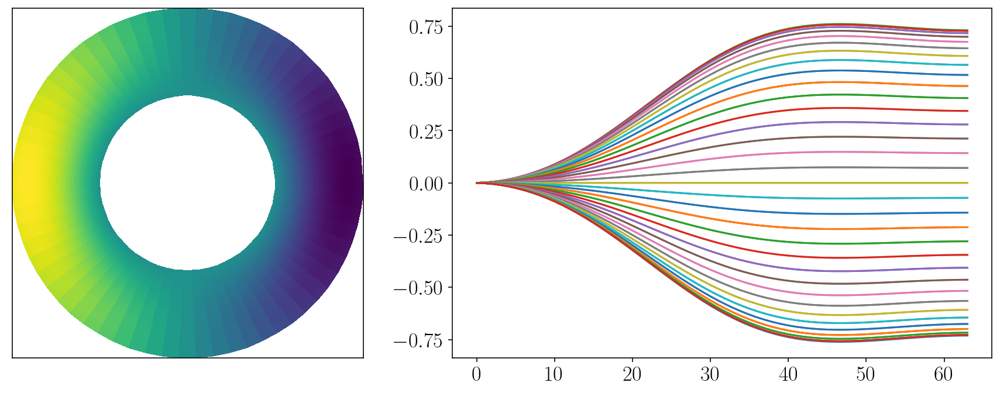

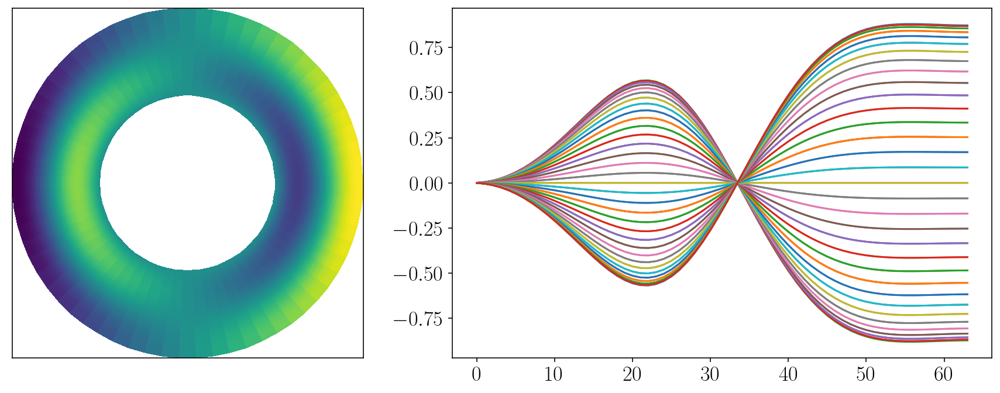

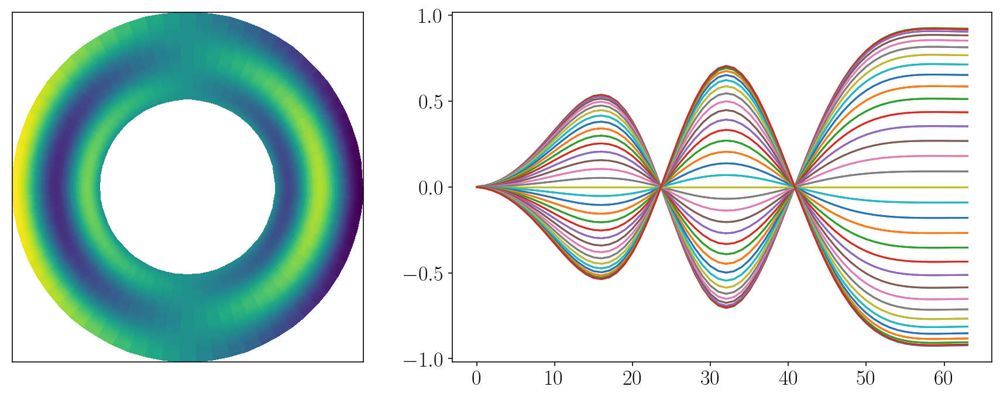

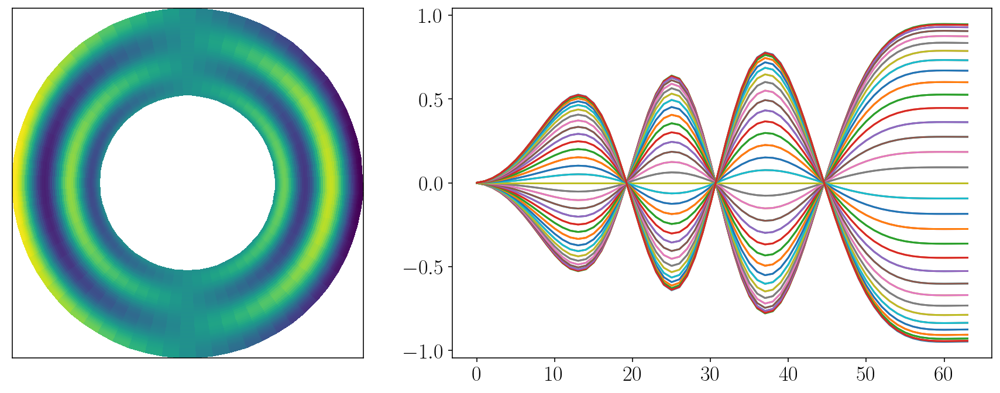

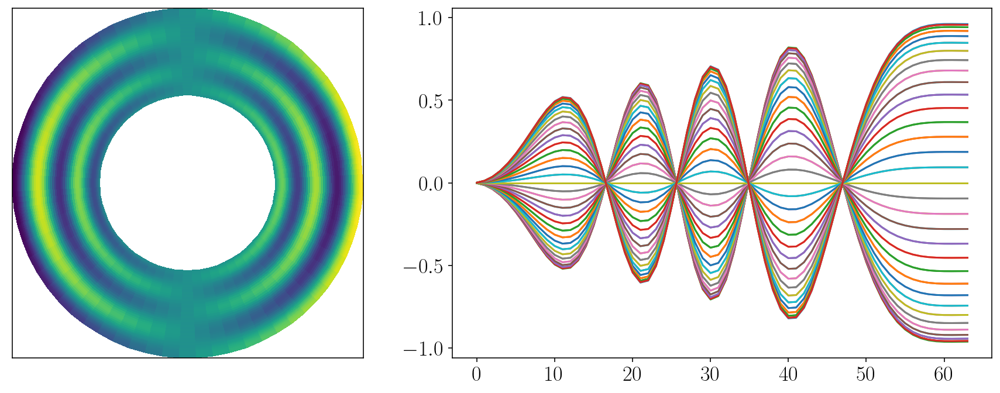

...

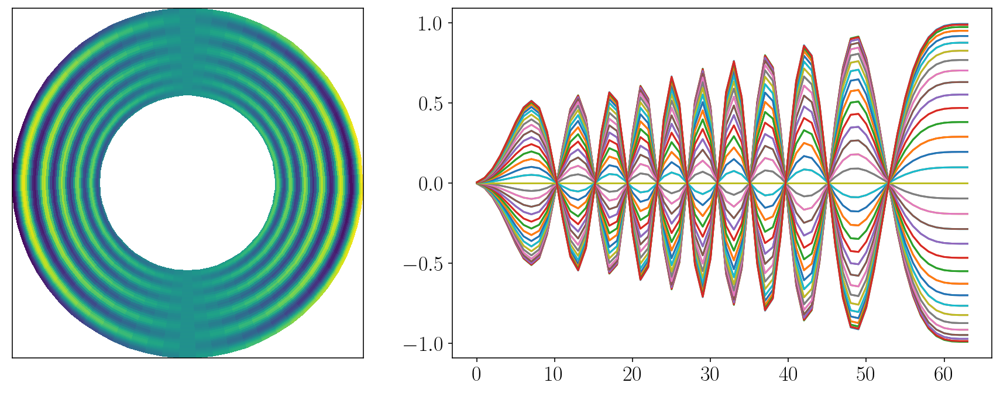

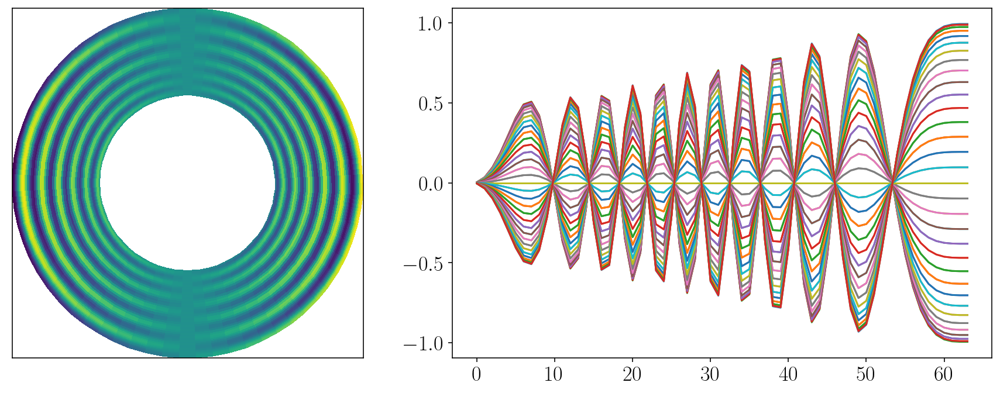

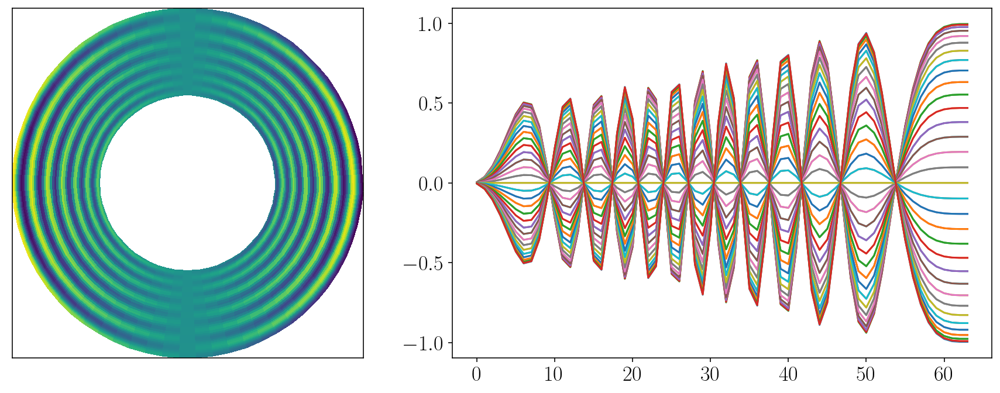

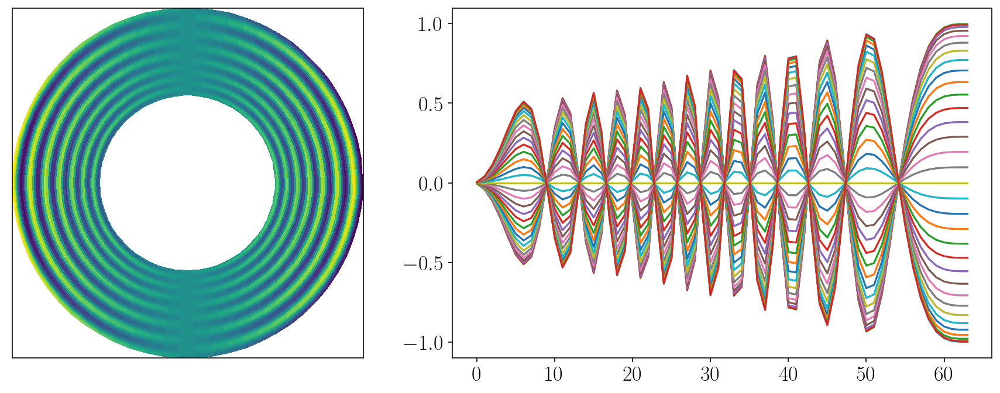

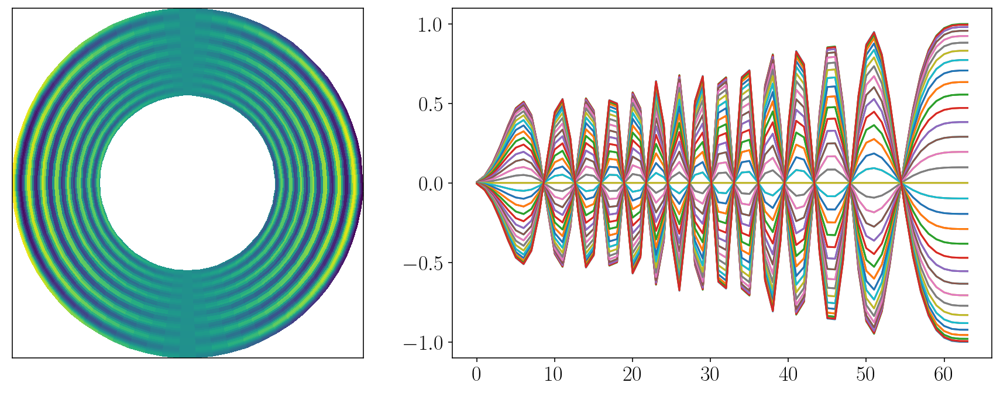

In [143]:
R,THETA = np.meshgrid(r,θ)
x = R*np.cos(THETA); y=R*np.sin(THETA)

for i in mode_order[:15]:
    fig,(ax,ax1) = plt.subplots(1,2, figsize=(15,5.5),gridspec_kw={'width_ratios': [1.3,2]})
    solver_coupled.set_state(chunk*(Nr+2)+i, solver_coupled.subsystems[0])
    ax.pcolormesh(x,y,(Φ['g'].real))
    for j in range(Nθ):
        ax1.plot(np.real(Φ['g'])[j,:])
    ax.set_xticks([]);ax.set_yticks([])
    plt.show()

But that's not always the case? Some are mixed...

In [203]:
np.argmin(np.abs(np.abs(1/solver_coupled.eigenvalues)-0.2491165))/(Nr+2)

62.96969696969697

In [204]:
chunk = 62 
eigs_chunk = solver_coupled.eigenvalues[chunk*(Nr+2):(chunk+1)*(Nr+2)]
mode_order = np.flip(np.argsort((np.real(1/eigs_chunk))))
eigs_order = np.flip(np.sort(np.abs((np.real(1/eigs_chunk)))))

In [205]:
eigs_order[:10]

array([0.26999368, 0.2491165 , 0.09046359, 0.06765058, 0.04018892,
       0.02199117, 0.01372037, 0.00933419, 0.00674653, 0.00509786])

In [206]:
np.abs(np.sort(1/solver_uncoupled.eigenvalues.real))[:10]

array([0.2491165 , 0.06765058, 0.02822239, 0.01508688, 0.00931243,
       0.00629931, 0.00453763, 0.00342137, 0.00267057, 0.00214182])

In [194]:
for j in range(len(mode_order)):
    i=mode_order[j]
    solver_coupled.set_state(chunk*(Nr+2)+i, solver_coupled.subsystems[0])
    print(j,np.max(Φ['g'].real))

0 0.7695688394935031
1 0.7601803559804662
2 0.8596024099533169
3 0.8662798321758918
4 0.9066202453880622
5 0.9331108929416985
6 0.9499576074059749
7 0.9610794002476801
8 0.9694846104839084
9 0.9754151474759049
10 0.9730293714399312
11 0.9786574994251162
12 0.9828371690867955
13 0.9864589079070953
14 0.9894936156472943
15 0.9920155416267669
16 0.9941430162568792
17 0.9959594692657263
18 0.9975254595999976
19 0.9988860487194633
20 1.0001417839617872
21 1.0013451738893357
22 1.002434488266803
23 1.003426385195561
24 1.0043343402397413
25 1.0051693803767594
26 1.0059406229887373
27 1.006655683234908
28 1.0073205920081059
29 1.0079383883266604
30 1.0084505915928261
31 1.0015452052336151
32 0.9593947146296755
33 0.675712446393688
34 0.12915645764060524
35 0.08565901450673816
36 0.019159142269337036
37 0.005281751951710559
38 0.005731653463526628
39 0.0012365448082378358
40 0.0006559997400023991
41 0.0004853292169972097
42 0.0004853300224004474
43 0.00019612773657904322
44 8.725095068357697e-

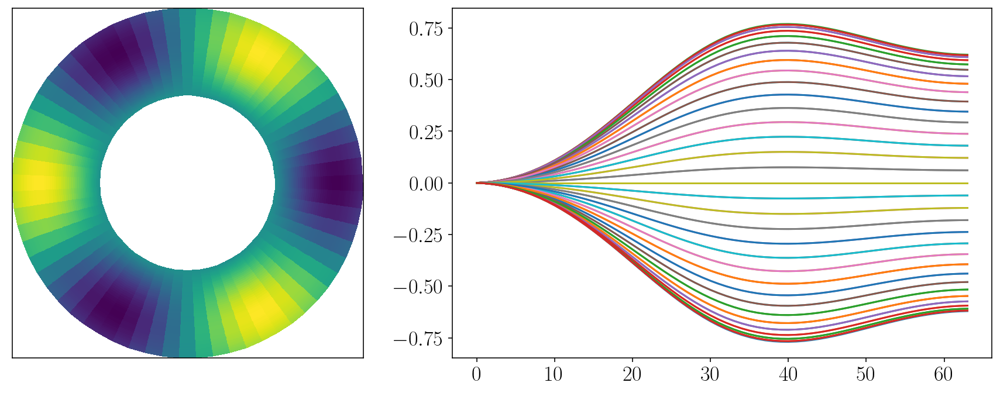

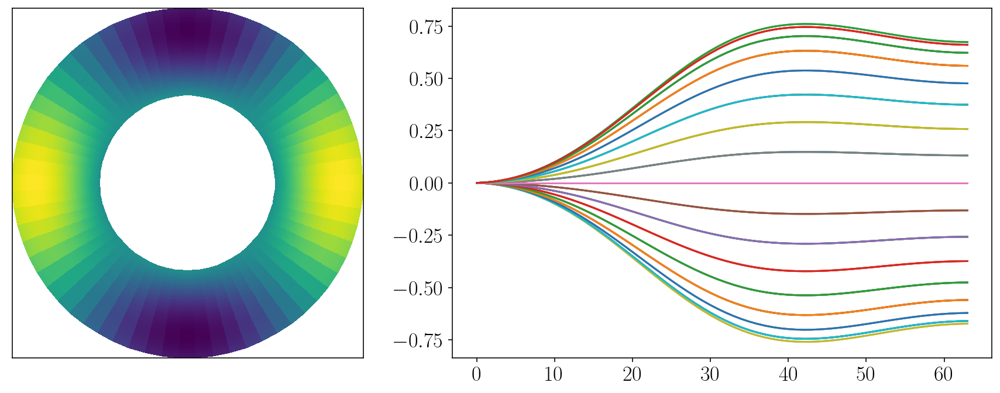

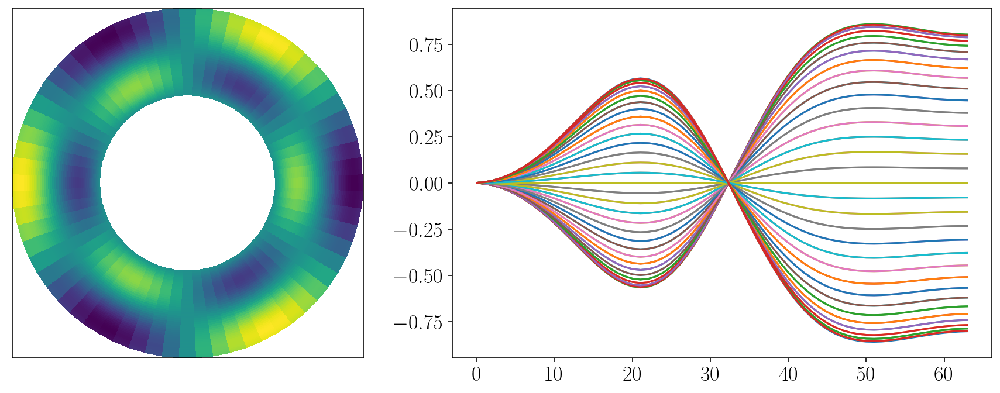

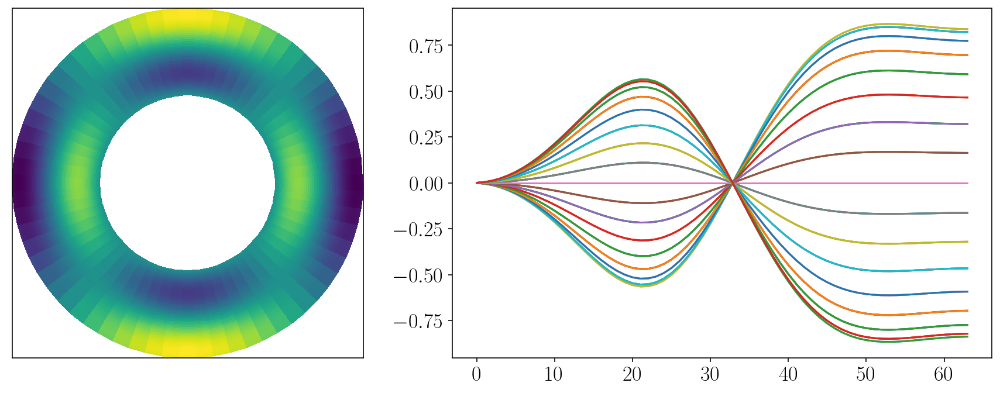

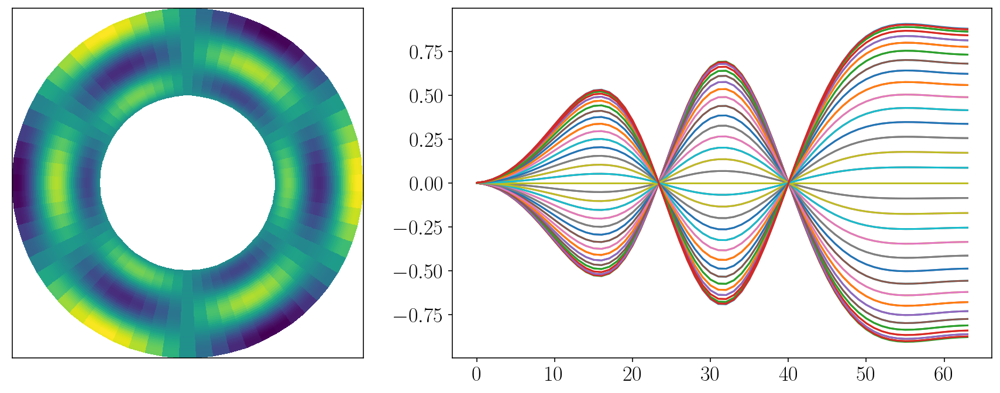

...

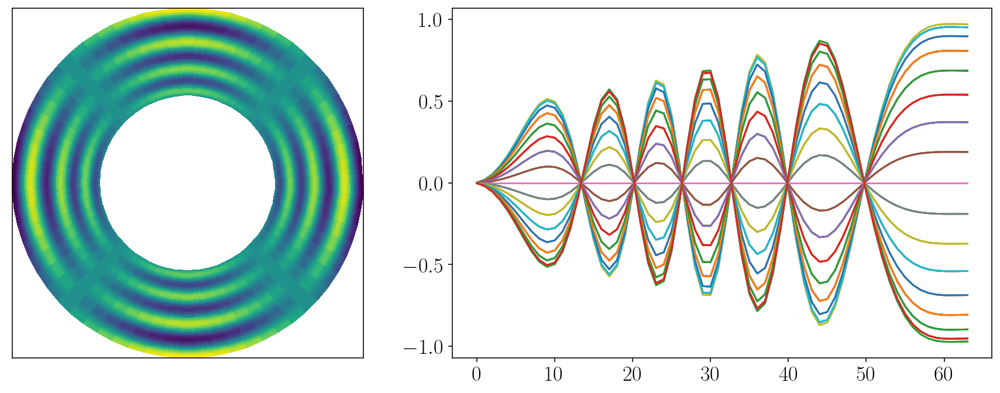

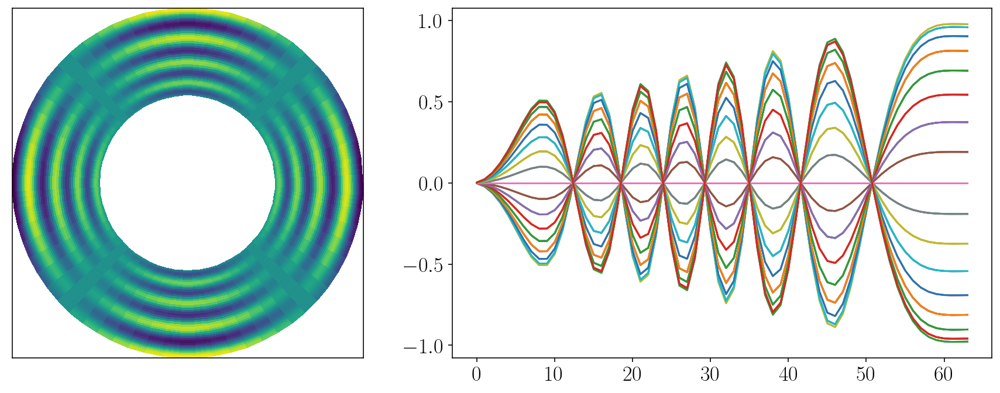

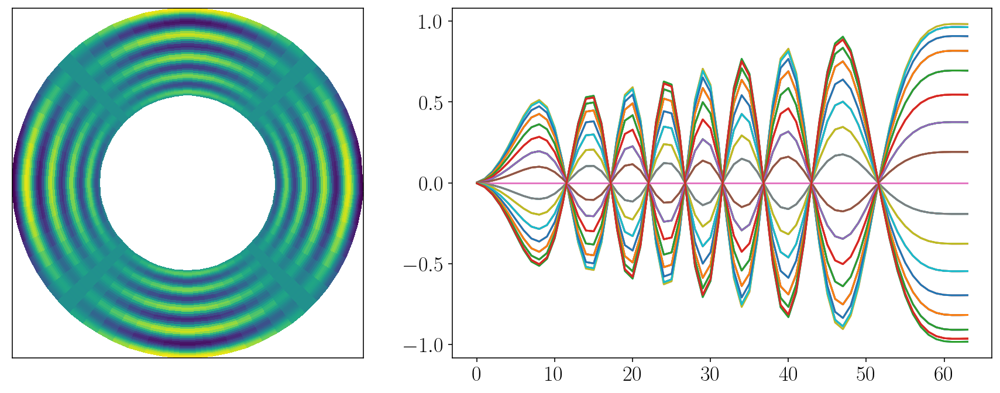

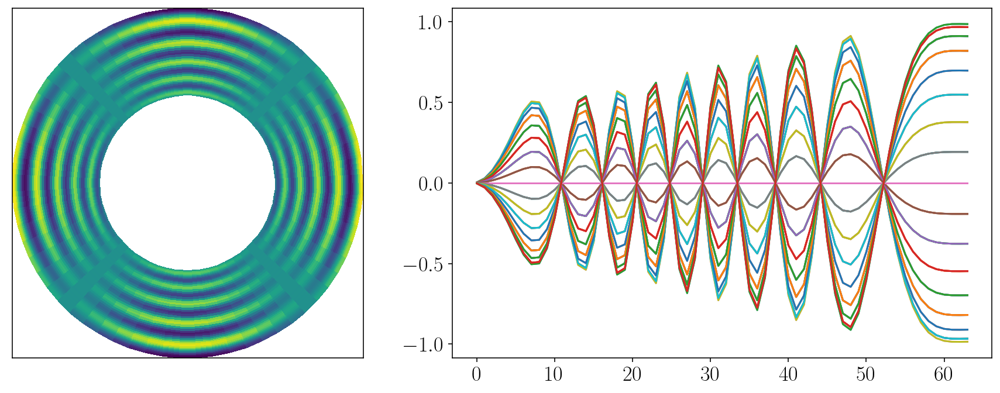

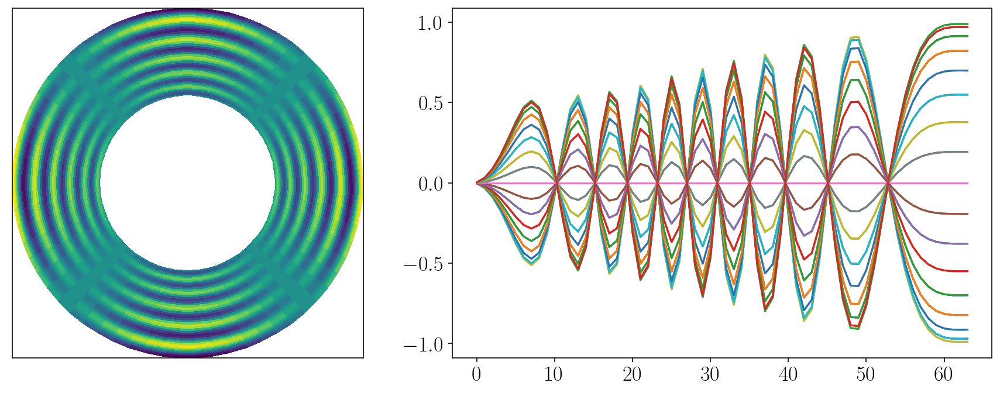

In [195]:
R,THETA = np.meshgrid(r,θ)
x = R*np.cos(THETA); y=R*np.sin(THETA)

for i in mode_order[:15]:
    fig,(ax,ax1) = plt.subplots(1,2, figsize=(15,5.5),gridspec_kw={'width_ratios': [1.3,2]})
    solver_coupled.set_state(chunk*(Nr+2)+i, solver_coupled.subsystems[0])
    ax.pcolormesh(x,y,(Φ['g'].real))
    for j in range(Nθ):
        ax1.plot(np.real(Φ['g'])[j,:])
    ax.set_xticks([]);ax.set_yticks([])
    plt.show()

### Dirichlet-to-Neumann BC (part 2 - extend past the shelf)

In [53]:
Ri, Ro, Rb = 0.5, 2, 1 #note - Ri (inner radius) is 'a' from previous, also we will now have Rb as a parameter for the shelf break / edge of the bathymetry 
Nθ, Nr = 64, 64 #resolution (want higher in r than θ)
α = 1 #bathymetry parameter

coords = d3.CartesianCoordinates('θ', 'r')
dist = d3.Distributor(coords, dtype=np.complex128)
θ_basis = d3.Fourier(coords['θ'], Nθ, (0, 2*np.pi), dtype=np.complex128)
r_basis = d3.Chebyshev(coords['r'], Nr, (Ri, Ro))
# Fields
Φ = dist.Field(name='Φ', bases=(θ_basis, r_basis))
tau1 = dist.Field(name='tau1', bases=θ_basis)
tau2 = dist.Field(name='tau2', bases=θ_basis)
ωinv = dist.Field(name='ωinv')
# Substitutions
dθ = lambda A: d3.Differentiate(A, coords['θ'])
dr = lambda A: d3.Differentiate(A, coords['r'])
θ, r = dist.local_grids(θ_basis, r_basis)
rinv = dist.Field(bases=r_basis)
rinv['g'] = r**(-1)
Hinv = dist.Field(bases=r_basis) #define the bathymetry - note this will differ in more complex problems, later will also be in θ_basis but not here
Hinv['g'] = r**(-2*α)
Hinv['g'][r>Rb] = 1
lift_basis = r_basis.derivative_basis(2)
tau_terms = d3.Lift(tau1, lift_basis, -1) + d3.Lift(tau2, lift_basis, -2)
m_func = lambda m: abs(m)
abs_m = lambda A: abs_m_cls(A, coords['θ']) #note this implements the Dirichlet-to-Neumann BC

# Problem
problem = d3.EVP([Φ, tau1, tau2], eigenvalue=ωinv, namespace=locals())
problem.add_equation("Hinv*(dr(dr(Φ)) + rinv*dr(Φ) + rinv**2*dθ(dθ(Φ))) + dr(Φ)*dr(Hinv) + rinv**2*dθ(Φ)*dθ(Hinv) + 1j*rinv*ωinv*(dr(Φ)*dθ(Hinv) - dθ(Φ)*dr(Hinv)) + tau_terms = 0 ")
problem.add_equation("Φ(r=Ri)=0") #inner BC
problem.add_equation("dr(Φ)(r=Ro) + abs_m(Φ)(r=Ro) / Ro = 0") #outer BC

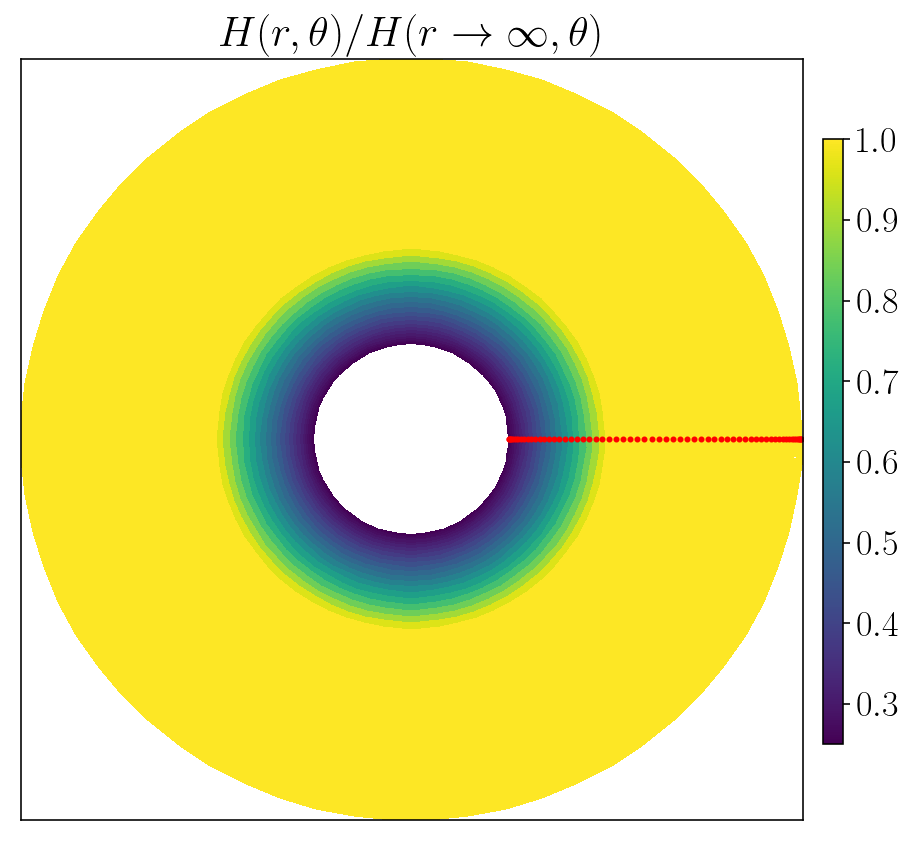

In [54]:
R,THETA = np.meshgrid(r,θ)
x = R*np.cos(THETA); y=R*np.sin(THETA)
# xr = R*np.cos(THETA*0); yr = R*np.sin(THETA*0)
fig,(ax) = plt.subplots(1,1, figsize=(7,7))
c=ax.pcolormesh(x,y,(R*0+1)*(1/Hinv['g'].real))
ax.plot(r,0,'ro', markersize=2)
ax.set_title(r'$H(r,\theta)/H(r\to\infty, \theta)$')
cax = fig.add_axes([0.92, 0.2, 0.02, 0.6])
cbar=plt.colorbar(c,cax = cax,orientation='vertical',shrink = 0.5)
ax.set_xticks([]);ax.set_yticks([])
plt.show()

In [55]:
# Solve (individual separable modes...)
solver_uncoupled = problem.build_solver()
solver_uncoupled.solve_dense(solver_uncoupled.subproblems[1]) 
np.abs(np.sort(1/solver_uncoupled.eigenvalues.real))[:10] 

2022-08-11 16:27:31,165 subsystems 0/1 INFO :: Building subproblem matrices 1/1 (~100%) Elapsed: 8s, Remaining: 0s, Rate: 1.2e-01/s


array([0.17248592, 0.03715675, 0.01466354, 0.00769257, 0.00470901,
       0.0031724 , 0.00228004, 0.00171758, 0.00134049, 0.00107573])

In [59]:
solver_uncoupled.eigenvalues

array([            inf+0.j,             inf+0.j, -2.59446037e+07+0.j,
        1.62511096e+07-0.j, -1.07242031e+07+0.j,  8.46293560e+06-0.j,
       -6.61722585e+06+0.j,  5.58841456e+06-0.j, -4.65285511e+06+0.j,
        4.05282794e+06+0.j, -3.47956670e+06+0.j,  3.08049503e+06-0.j,
       -2.68926684e+06+0.j,  2.40182147e+06-0.j, -2.11606721e+06+0.j,
        1.89798366e+06-0.j, -1.67959289e+06+0.j,  1.50820727e+06-0.j,
       -1.33599881e+06+0.j,  1.19800979e+06-0.j, -1.05920860e+06+0.j,
        9.46261359e+05+0.j, -8.32659815e+05+0.j,  7.39231103e+05+0.j,
       -6.45285025e+05+0.j,  5.67590449e+05+0.j, -4.89398561e+05+0.j,
        4.24802149e+05-0.j, -3.59518027e+05+0.j,  3.06220607e+05+0.j,
       -2.51680078e+05+0.j,  2.08581508e+05+0.j, -1.63070501e+05+0.j,
        1.29542126e+05+0.j, -9.20299040e+04+0.j,  6.66577822e+04+0.j,
       -6.19085886e+04+0.j, -3.90313916e+04+0.j, -2.39403018e+04+0.j,
        1.89115478e+04-0.j, -1.12755010e+04+0.j, -8.17616108e+03+0.j,
       -6.49887346e+

In [58]:
(np.sort(1/solver_uncoupled.eigenvalues)) 

array([-1.72485919e-01-0.j, -3.71567470e-02-0.j, -1.46635428e-02-0.j,
       -7.69256592e-03-0.j, -4.70900909e-03-0.j, -3.17240235e-03-0.j,
       -2.28003958e-03-0.j, -1.71757846e-03-0.j, -1.34049214e-03-0.j,
       -1.07573205e-03-0.j, -8.82240596e-04-0.j, -7.37239226e-04-0.j,
       -6.25004635e-04-0.j, -5.36852953e-04-0.j, -4.65792934e-04-0.j,
       -4.09005104e-04-0.j, -3.61681291e-04-0.j, -3.17519627e-04-0.j,
       -2.65654019e-04-0.j, -2.12614756e-04-0.j, -1.53872822e-04-0.j,
       -1.22306788e-04-0.j, -8.86878549e-05-0.j, -4.17705679e-05-0.j,
       -2.56204035e-05-0.j, -1.61528477e-05-0.j, -1.08660333e-05-0.j,
       -6.13231695e-06-0.j, -3.97329820e-06-0.j, -2.78150169e-06-0.j,
       -2.04332436e-06-0.j, -1.54970279e-06-0.j, -1.20097065e-06-0.j,
       -9.44101092e-07-0.j, -7.48503661e-07-0.j, -5.95382373e-07-0.j,
       -4.72574781e-07-0.j, -3.71848560e-07-0.j, -2.87392105e-07-0.j,
       -2.14921801e-07-0.j, -1.51120730e-07-0.j, -9.32470219e-08-0.j,
       -3.85436607e-

In [46]:
%%time
solver_coupled = problem.build_solver(matrix_coupling=(True,True))
solver_coupled.solve_dense(solver_coupled.subproblems[0])

2022-08-10 14:17:16,498 subsystems 0/1 INFO :: Building subproblem matrices 1/1 (~100%) Elapsed: 4s, Remaining: 0s, Rate: 2.3e-01/s
CPU times: user 37min 10s, sys: 22.8 s, total: 37min 33s
Wall time: 38min 29s


In [47]:
mode_order = np.flip(np.argsort((np.real(1/solver_coupled.eigenvalues))))
eigs_order = np.flip(np.abs(np.sort((np.real(1/solver_coupled.eigenvalues)))))

In [48]:
eigs_order[:20]

array([0.26984428, 0.26517416, 0.25044014, 0.24890042, 0.23274349,
       0.21509872, 0.19867357, 0.18382655, 0.17248592, 0.17057346,
       0.1587955 , 0.14833129, 0.13901639, 0.13069914, 0.12376927,
       0.12367296, 0.12324572, 0.12203179, 0.12157488, 0.11939044])

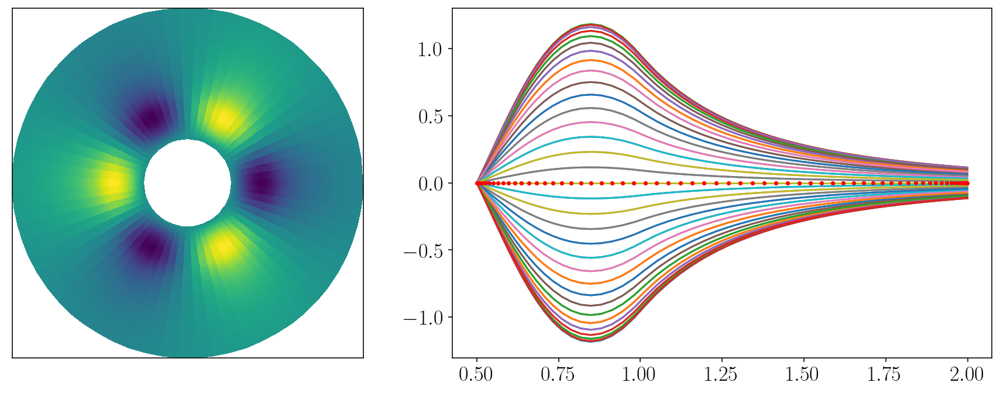

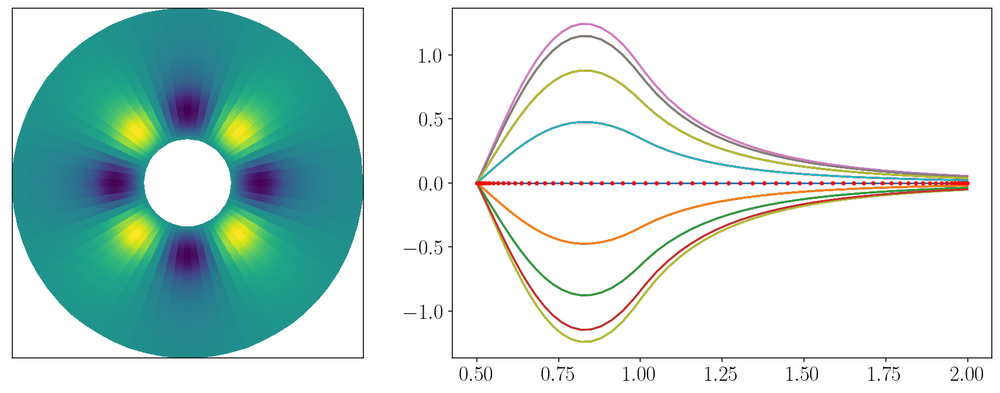

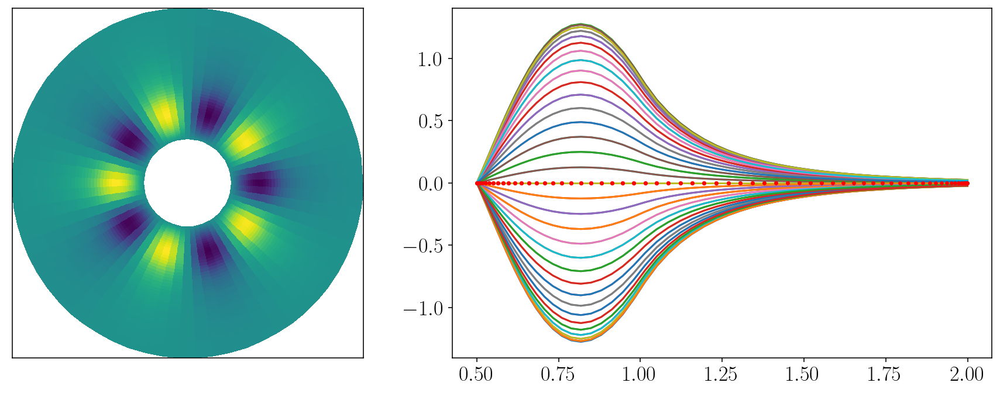

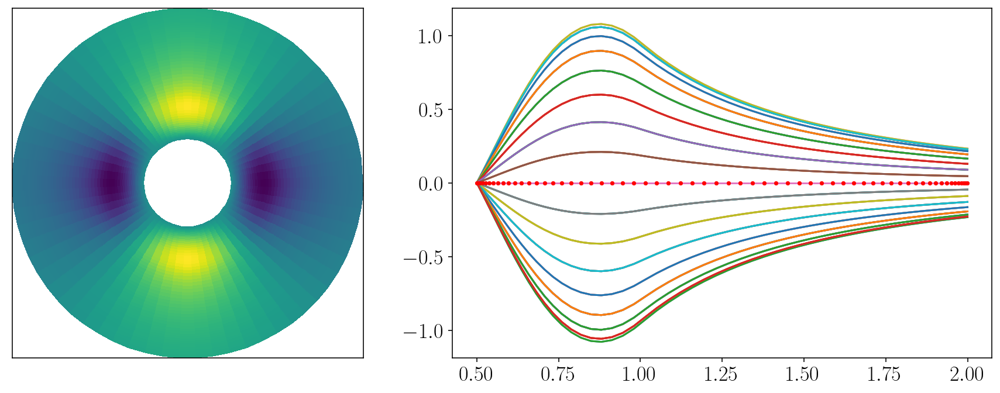

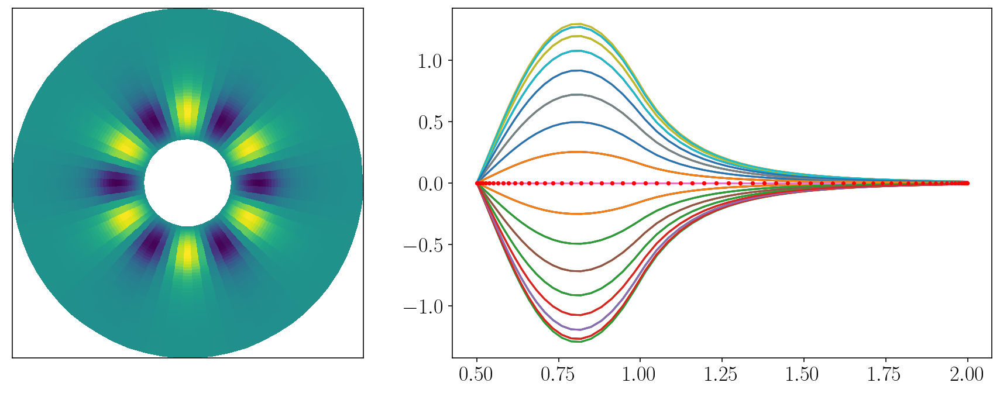

...

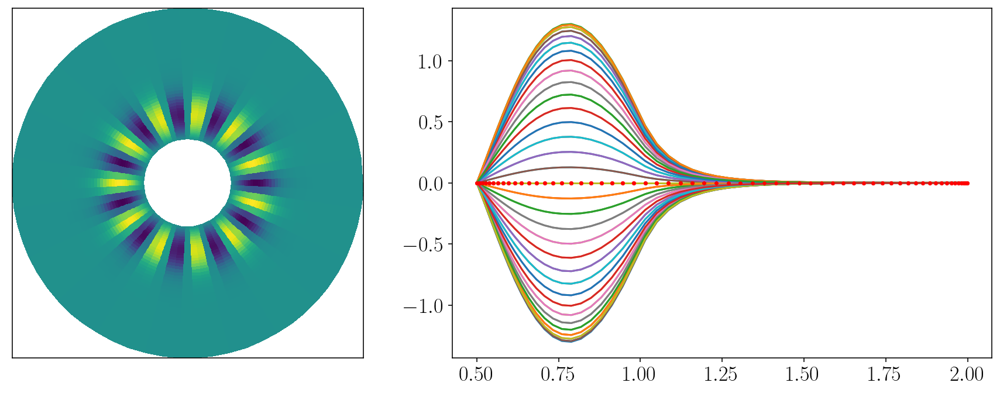

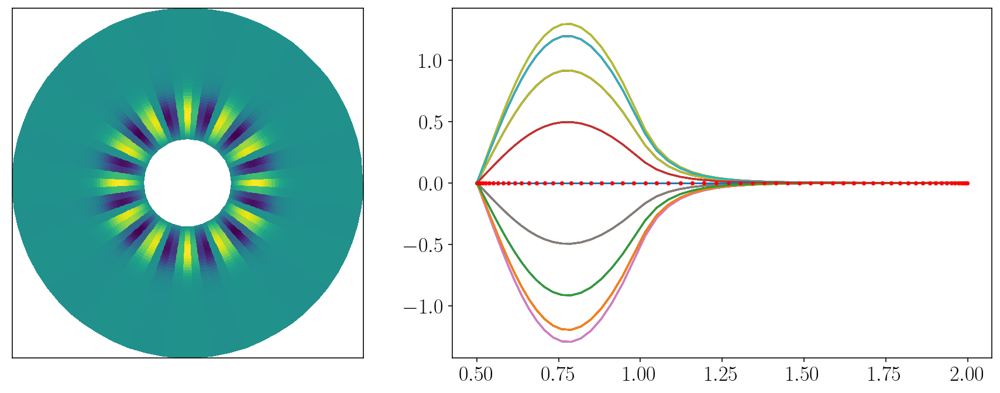

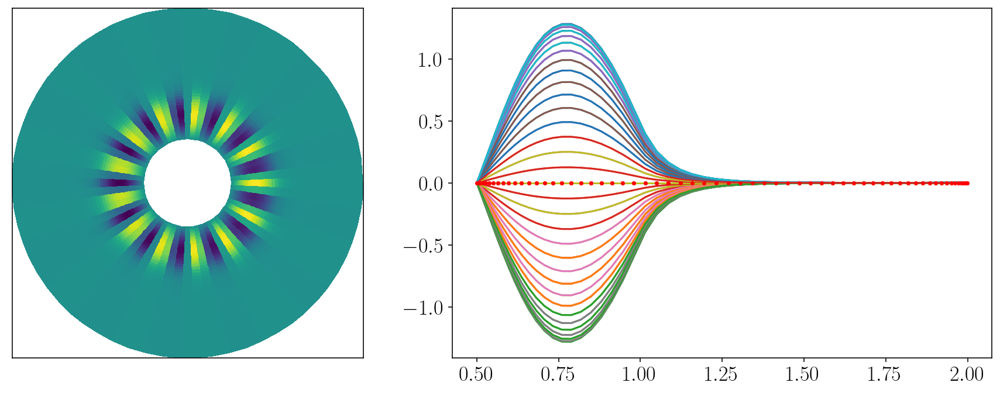

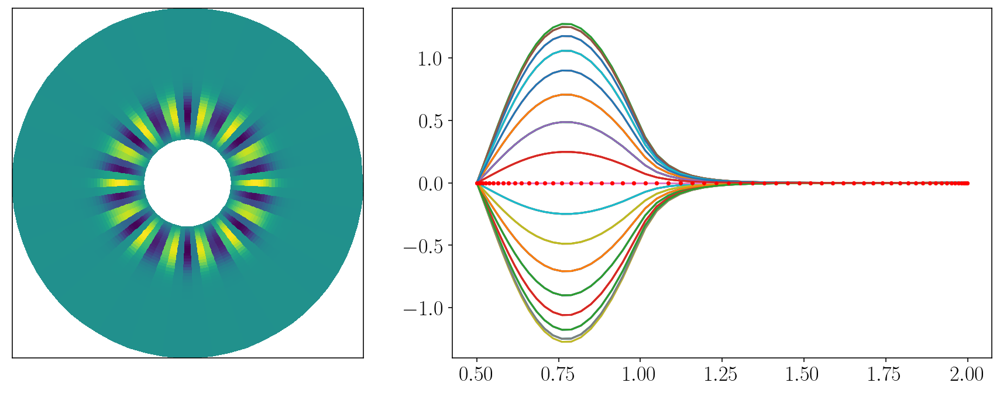

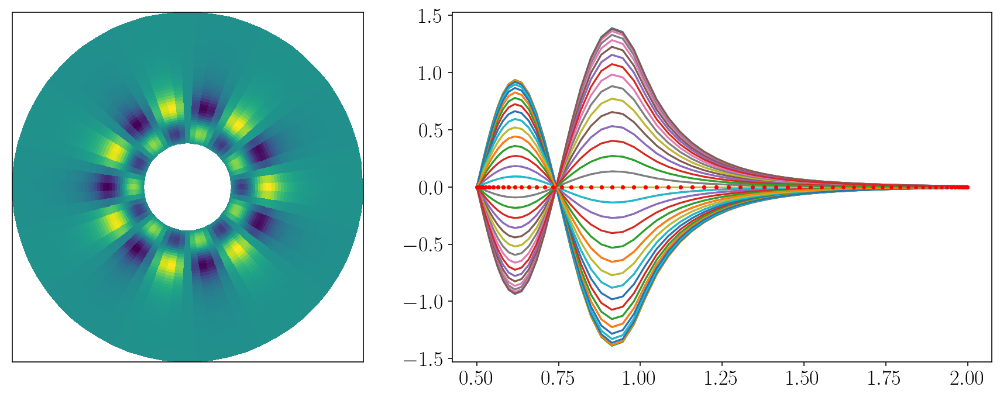

In [49]:
R,THETA = np.meshgrid(r,θ)
x = R*np.cos(THETA); y=R*np.sin(THETA)

for i in mode_order[:15]:
    fig,(ax,ax1) = plt.subplots(1,2, figsize=(15,5.5),gridspec_kw={'width_ratios': [1.3,2]})
    solver_coupled.set_state(i, solver_coupled.subsystems[0])
    ax.pcolormesh(x,y,(Φ['g'].real))
    for j in range(Nθ):
        ax1.plot(r.T,np.real(Φ['g'])[j,:])
        ax1.plot(r,0,'ro', markersize=2)
    ax.set_xticks([]);ax.set_yticks([])
    plt.show()